In [47]:
import librosa
from pathlib import Path
from IPython.display import display
import matplotlib.pyplot as plt
import numpy as np
import scipy
import sklearn

In [4]:
root = Path('..')
audio_data = Path(root / "data" / "music-library-analysis-dataset")
# use the name as a key, get the path from the daatframe
audio_dict = {}
for index, f in enumerate(audio_data.iterdir()):
    if f.suffix in ['.wav', '.mp3', '.aiff', "flac"]:
        #get the name without the suffix
        audio_dict[f.stem] = f.as_posix()
display(audio_dict)

{'37 - Neverland (Aparde Remix)': '../data/music-library-analysis-dataset/37 - Neverland (Aparde Remix).mp3',
 'Intensity_Fluctuations_-_Ø_[Phase]_(Setaoc_Mass_remix)': '../data/music-library-analysis-dataset/Intensity_Fluctuations_-_Ø_[Phase]_(Setaoc_Mass_remix).mp3',
 'Artaphine - Toru Ikemoto - _080 [Artaphine Premiere]': '../data/music-library-analysis-dataset/Artaphine - Toru Ikemoto - _080 [Artaphine Premiere].mp3',
 '01 Heal My Soul': '../data/music-library-analysis-dataset/01 Heal My Soul.aiff',
 '01 Power to the Soul': '../data/music-library-analysis-dataset/01 Power to the Soul.aiff',
 'Aus_der_Tiefe_der_Zeit_-_Obscure_Shape,_SHDW_(Original_Mix)': '../data/music-library-analysis-dataset/Aus_der_Tiefe_der_Zeit_-_Obscure_Shape,_SHDW_(Original_Mix).mp3',
 '1-02 Tide': '../data/music-library-analysis-dataset/1-02 Tide.aiff',
 'Last_Charms_-_Hyden_(Alarico_Remix)_(SYEP009)': '../data/music-library-analysis-dataset/Last_Charms_-_Hyden_(Alarico_Remix)_(SYEP009).mp3',
 '03 For Marco'

# Get sample rate of audio 
- x is the audio array. We have mono adio files. Multi channel would have multiple dimensions
- x is based on the sample rate * duration in seconds. Each sample is an amplitude, and the entire wave is normalized to a raneg of [-1,1]
- sample rate is the number of samples per second. oroginal sample rate from encoded file used

In [63]:
x, sr = librosa.load(audio_dict['1-01 Funken'])
print(x.shape)
print(sr)
print("length of song is", (x.size/sr)/60)

(6529557,)
22050
length of song is 4.9354172335600905


# Get display of audio wave

- This audio signal right now is too long timewise to see anythng meaningful. Ways to fix:
- get shorter time slice
- change sampling density
- it is between -1, 1 showing the amplitude

this function switches between 'matplotlib.pyplot.step', which makes discrete steps relative to some axis


for short time windows, we can see every single sample

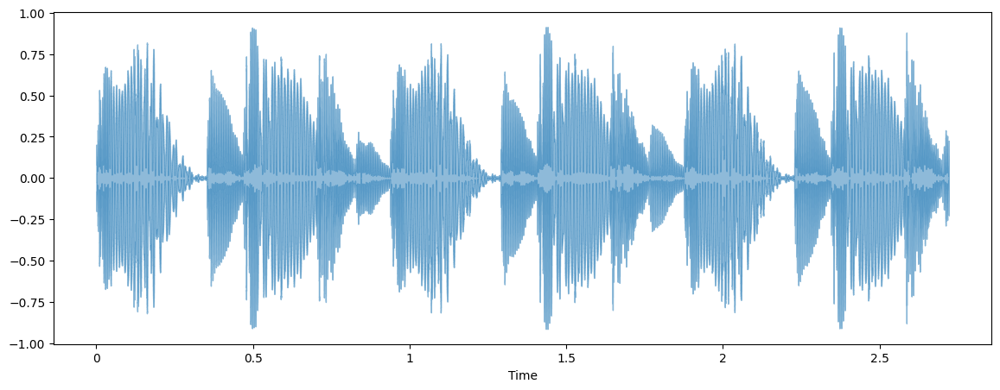

In [72]:
plt.figure(figsize=(14, 5))
maxpoints = 16000 # sample less than a second
librosa.display.waveshow(x[0:60000], sr=22050, alpha=0.5)

for longer windows, we have a downsampled plot. This shows the overall outline of the waveform
- instead of everypoint, we fill between small time bins


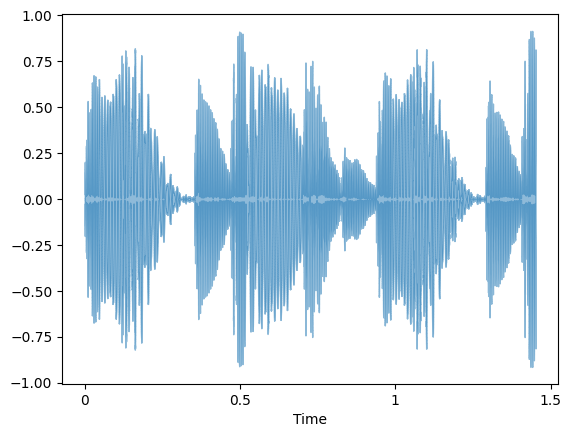

In [75]:
librosa.display.waveshow(x[0:32000], sr=22050, alpha=0.5)

For some reason, getting the aiff file doesnt work

In [ ]:
import IPython.display as ipd
ipd.Audio(np.asarray(x), rate= 22050)  # load a local WAV file

 We can generate sin, cos waves, superimpose them, then play them.

In [ ]:
sr = 22050 # sample rate
T = 2.0    # seconds
t = np.linspace(0, T, int(T*sr), endpoint=False) # time variable
x = 0.5*np.sin(2*np.pi*880*t)  # f, s
ipd.Audio(x,rate = sr) #

We can make spectrograms

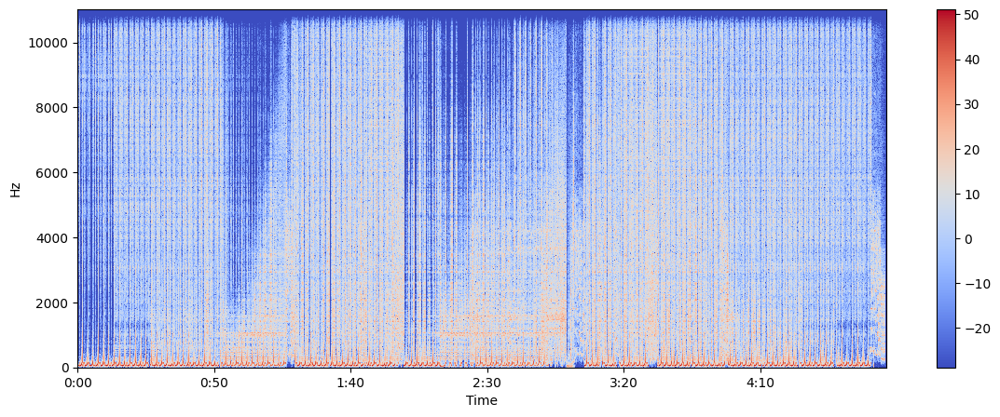

In [64]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

In [66]:
x, sr = librosa.load(audio_dict['in_aeternam'])
ipd.Audio(x, rate=sr)

sometimes, sound has the same pitch/loudness *timbre* is what lets is distinguish the various sounds. We can model attack, sustain, release, decay

In [82]:
T = 2.0 # seconds
f0 = 1047.0
sr = 22050
t = np.linspace(0, T, int(T*sr), endpoint=False) # time variable
x = 0.1*np.sin(2*np.pi*f0*t)
ipd.Audio(x, rate=sr)

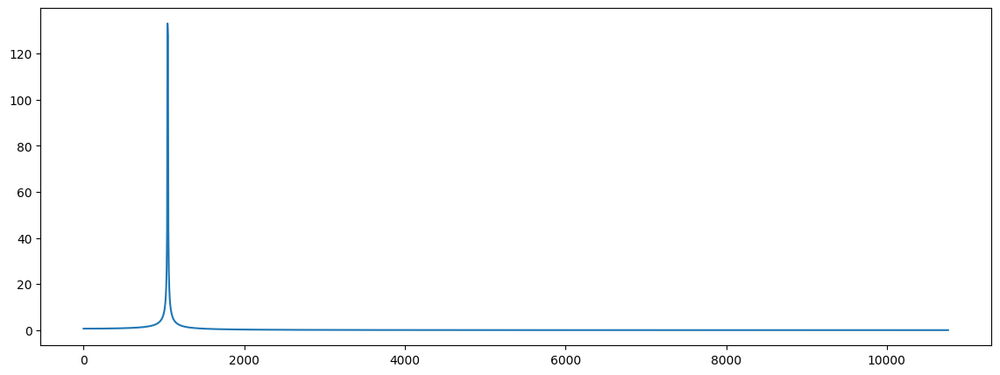

In [86]:
X = scipy.fft.fft(x[:4096])
f = np.linspace(0, sr, 4096)
X_mag = np.abs(X)
plt.figure(figsize =(14,5))
plt.plot(f[:2000],X_mag[:2000])

We can look at differences in the timbres by looking at the timbres. they are computed with FFTs to look at the distributions of frequencies (X-axis) and amplitudes

# Fundemental Frequenies and Waves
- different tuning have different ways to step through the tones. The above spectograms of the FFT magnitude (strength) versus frequency. the peaks are the harmonics
- all harmnics are periodic in fundemental frequency (meaning any repeats in value in the wave happen in intervals of f_0)
- since all the frequencies are evenly spaced on the histogram, we can see that the harmanics occur at rates of z*f

In [97]:
T = 5     # duration in seconds
sr = 22050  # sampling rate in Hertz
fcutoff = 4000 # frequency cutoff for filter

In [106]:
def simulate_tone(f0, harmonics=None):
    """Returns a tone with a specified fundamental frequency and harmonic amplitudes."""
    if harmonics is None:
        harmonics = [1]
    t = np.linspace(0, T, T*sr, endpoint=False)
    x = sum(v*np.sin(2*np.pi*i*f0*t) for i, v in enumerate(harmonics, 1))
    return x

In [110]:
def filter_tone(x, fcutoff=None):
    """Return a low-pass filtered signal."""
    if fcutoff is None:
        fcutoff = sr/2.0
    h = scipy.signal.firwin(55, 2*float(fcutoff)/sr)
    y = scipy.signal.convolve(x, h)
    return y

In [115]:
def make_double_stop(ratio, f0=440, harmonics=None):
    """Listen to two tones played simultaneously, and plot the tones' spectra."""
    if harmonics is None:
        harmonics = [1]
    f1 = ratio*f0
    
    # Generate both tones.
    x0 = filter_tone(simulate_tone(f0, harmonics=harmonics), fcutoff=fcutoff)
    x1 = filter_tone(simulate_tone(f1, harmonics=harmonics), fcutoff=fcutoff)
    
    # Add both tones, and normalize.
    y = x0 + x1
    y = 0.5*y/y.max()
    
    # Generate both spectra.
    X0 = scipy.fft.fft(x0)
    X1 = scipy.fft.fft(x1)

    # Create frequency variable.
    N = len(X0)
    f = np.linspace(0, sr, N, endpoint=False)
    
    # Plot spectrum of both notes.
    plt.semilogy(f, abs(X0), marker='o', linewidth=1)
    plt.semilogy(f, abs(X1), color='r', linewidth=1)
    
    plt.xlim(xmin=0, xmax=(len(harmonics)+1)*(f1 if ratio > 1 else f0))
    plt.ylim(ymin=0.1)
    
    plt.xlabel('Frequency (Hz)')
    plt.legend(('f0 = %.2f Hz' % f0, 'f1 = %.2f Hz' % f1))
    
    # Output audio widget.
    print('ratio between notes:', ratio)
    print('difference in cents:', np.log2(ratio)*1200)
    return ipd.Audio(y, rate=sr)

ratio between notes: 1
difference in cents: 0.0


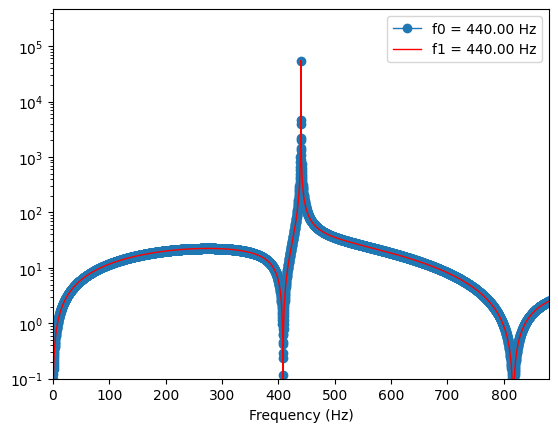

In [116]:
make_double_stop(1)

# Understanding Audio Features through Sonification
- onset in signals
- segmentation at onsets
- features of each segment
- intuition of features by listening

In [134]:
x, sr = librosa.load(audio_dict['Thinking_Of_You_feat._Camille_Safiya_-_Serge_Devant,_Camille_Safiya,_Damiano_C_(Serge_Devant_s_Floor_Cut)'])
print(x) #audio bits (time in seconds * sr)
print(sr) #sampling rate (bits per second)

[ 0.00261006  0.00663915  0.00812447 ... -0.00013851 -0.00029753
 -0.00032021]
22050


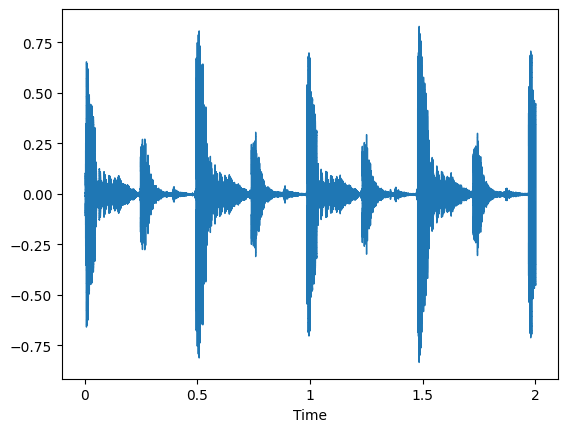

In [128]:
librosa.display.waveshow(x[0:2*22050], sr=sr)

Remember, converting from amplitude to dB, we use a formula that relates a base relative amplitude to the given amplitude. We can use the fundemental frequency of hearing as a base signal 
- below is 2 seconds of audio

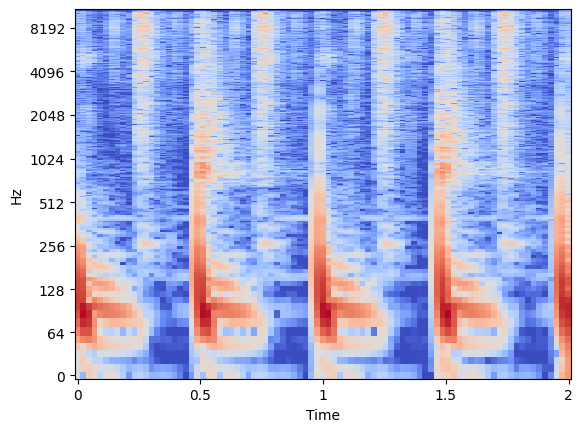

In [139]:
X= librosa.stft(x[0: 2*sr])
X_mag = librosa.amplitude_to_db(np.abs(X))
librosa.display.specshow(X_mag, sr=sr, x_axis='time', y_axis='log')


- get frame indices from audi array of the onsets. frames are a short block on contiguos samples used by STFT and other algorithms, and are not the indices from the original audio

In [151]:
onset_frames = librosa.onset.onset_detect(y=x[0:4*sr], sr = sr)
print(onset_frames)

[ 12  22  33  43  54  64  75  86  96 107 118 128 134 139 149 160 170]


- convert to time of onset

In [152]:
onset_times = librosa.frames_to_time(onset_frames, sr=sr)
print(onset_times)

[0.27863946 0.510839   0.7662585  0.99845805 1.25387755 1.4860771
 1.7414966  1.9969161  2.22911565 2.48453515 2.73995465 2.9721542
 3.11147392 3.2275737  3.45977324 3.71519274 3.94739229]


- convert to sampling indices from the original audio array x

In [159]:
onset_samples =librosa.frames_to_samples(onset_frames)
print(onset_samples)

[ 6144 11264 16896 22016 27648 32768 38400 44032 49152 54784 60416 65536
 68608 71168 76288 81920 87040]


- get the clicks of the audio onset times

In [160]:
clicks = librosa.clicks(times= onset_times, sr=sr, length=len(x[0:4*sr]))
ipd.Audio(clicks, rate=sr)

## Audio Segmentation

In [170]:
frame_sz = int(.100*sr)
print(frame_sz)
print(onset_samples)
segments = np.array([x[i:i+frame_sz] for i in onset_samples])
print(segments.shape)

2205
[ 6144 11264 16896 22016 27648 32768 38400 44032 49152 54784 60416 65536
 68608 71168 76288 81920 87040]
(17, 2205)


In [173]:
#pad time is a percentage of sr to add as silence after each segment, the combine into 1 signal
def concat_segments(segments, sr = 22050, pad_time = .300):
   # add pad time to each segmemnt in the passed segments array
   padded_segments = [np.concatenate([seg, np.zeros(int(pad_time*sr))]) for seg in segments]
   return np.concatenate(padded_segments)

In [174]:
concatenated_signal = concat_segments(segments, sr=sr, pad_time=.300)

- with the padded times it sounds slower

In [175]:
ipd.Audio(concatenated_signal, rate=sr)

# Extracting Features - Crossing Rate from segments

- zero crossing rate for each segment

In [ ]:
zcrs = [sum(librosa.core.zero_crossings(segment)) for segment in segments]
print(zcrs)


[np.int64(1245), np.int64(148), np.int64(1197), np.int64(40), np.int64(1240), np.int64(152), np.int64(1236), np.int64(41), np.int64(1266), np.int64(128), np.int64(1182), np.int64(42), np.int64(321), np.int64(1262), np.int64(141), np.int64(1243), np.int64(35)]


- sort by zero crossing rate

In [178]:
ind = np.argsort(zcrs)
print(ind)

[16  3  7 11  9 14  1  5 12 10  2  6  4 15  0 13  8]


- this creates a signal the same length as the concatenanted signal, but sorted in order of crossing rates

In [180]:
concatenated_signal = concat_segments(segments[ind], sr)
ipd.Audio(concatenated_signal, rate=sr)

# Basic feature Extraction

- think this would sort the lowest frequency elements first, then the highest frequency elements
- can partition the frames somehow maybe, and do aggregations along longer time segements


Excersise: ectract the zero crossing rate and spectral centroid, then do k-means clustering

In [ ]:
# Have 30 songs
# For each song: get the 1st segement
# On each song, get the spectral centroid and zero crossing rate -> total daataset: (30, 2) : (songs, features)

In [ ]:
# pass in frame size as the percentage
def segment_signal(signal, frame_sz):
    #iterate over the signal, and return an array of segments 
    frame_step = int(frame_sz * len(signal)) #perctenage of signal length 
    return np.arrary(signal[i: i+ frame_step] for i in range(0))
    return 


- Substringing the audio signal does not change the frame size or any other parameters used for windowing 

In [ ]:
def get_features(signal, sig_sr=22050, seconds = .1):
     sig_segment = signal[0:sig_sr*seconds]
     return np.array(
           [librosa.feature.spectral_centroid(y=sig_segment)[0,0],
            librosa.feature.zero_crossing_rate(y=sig_segment)[0,0]]
     )

In [45]:
song_features = []
for name, path in audio_dict.items():
    #read and store the signals
    signal, sr = librosa.load(path)
    song_features.append(get_features(signal, 22050, 1))
song_features = np.array(song_features)
print(song_features)


[[0.00000000e+00 0.00000000e+00]
 [2.44621514e+03 2.08007812e-01]
 [5.04654408e+03 1.69433594e-01]
 [3.15834856e+02 1.51367188e-02]
 [0.00000000e+00 0.00000000e+00]
 [4.12484533e+03 7.56835938e-02]
 [6.32304208e+02 8.30078125e-03]
 [4.89665609e+02 7.81250000e-03]
 [2.95044048e+03 2.00195312e-02]
 [3.81702169e+02 1.70898438e-02]
 [1.16870775e+03 2.73437500e-02]
 [7.28660668e+02 6.25000000e-02]
 [4.46719606e+03 1.59667969e-01]
 [0.00000000e+00 0.00000000e+00]
 [1.12932699e+03 8.30078125e-03]
 [1.16115368e+03 1.22070312e-02]
 [1.22251764e+03 2.19726562e-02]
 [1.82822787e+03 1.56250000e-02]
 [0.00000000e+00 0.00000000e+00]
 [2.62939766e+03 3.22265625e-02]
 [6.19376069e+02 5.66406250e-02]
 [1.00701861e+03 1.17187500e-02]
 [2.35191345e+03 2.88085938e-02]
 [5.22525262e+03 2.62695312e-01]
 [2.15605858e+03 1.61132812e-02]
 [2.65725318e+03 1.40625000e-01]
 [1.65948004e+03 1.80664062e-02]
 [1.13138208e+03 6.34765625e-03]]


In [46]:
display(song_features[:,1])

array([0.        , 0.20800781, 0.16943359, 0.01513672, 0.        ,
       0.07568359, 0.00830078, 0.0078125 , 0.02001953, 0.01708984,
       0.02734375, 0.0625    , 0.15966797, 0.        , 0.00830078,
       0.01220703, 0.02197266, 0.015625  , 0.        , 0.03222656,
       0.05664062, 0.01171875, 0.02880859, 0.26269531, 0.01611328,
       0.140625  , 0.01806641, 0.00634766])

Text(0, 0.5, 'Count')

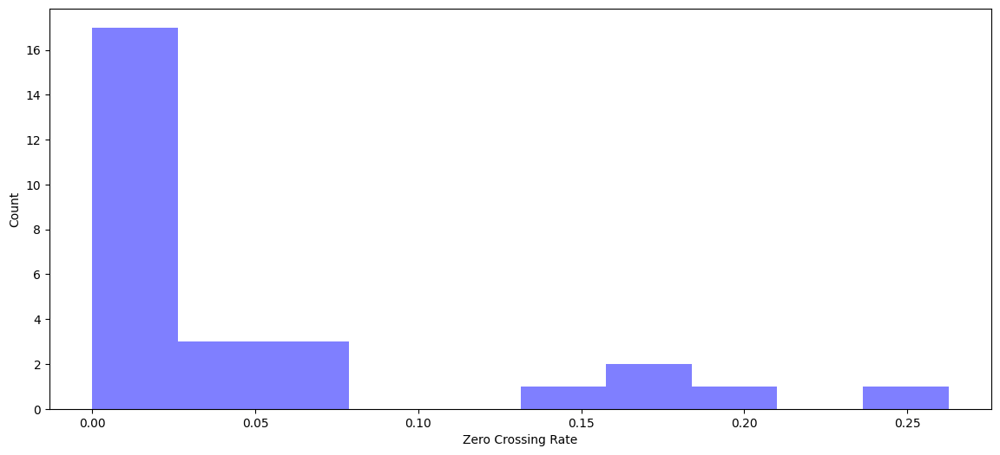

In [40]:
plt.figure(figsize=(14, 6))
plt.hist(song_features[:,1], color='b', alpha =.5)
plt.xlabel('Zero Crossing Rate')
plt.ylabel('Count')

Text(0, 0.5, 'Count')

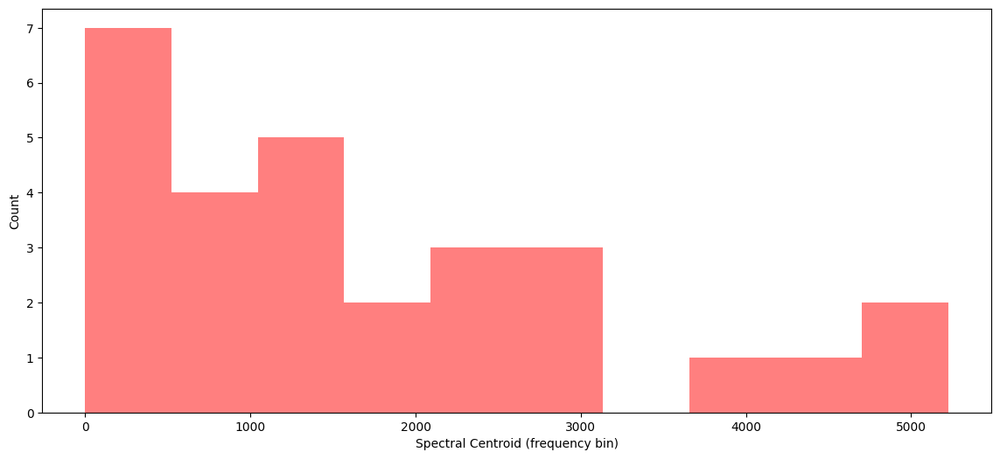

In [41]:
plt.figure(figsize=(14, 6))
plt.hist(song_features[:,0], color='r', alpha =.5)
plt.xlabel('Spectral Centroid (frequency bin)')
plt.ylabel('Count')

# Normalize both features and create a scatter plot. we want to normalize for curse of dimensionality in clustering

In [48]:
scaler = sklearn.preprocessing.MinMaxScaler(feature_range=(-1,1))
